In [1]:
import pandas as pd
import matplotlib
from matplotlib import pyplot as plt

In [2]:
from statsmodels.tsa.seasonal import seasonal_decompose

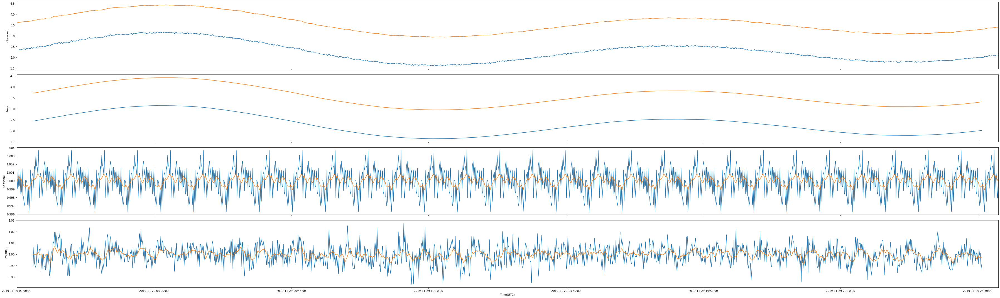

In [23]:
result = seasonal_decompose(series, model='multiplicative', freq= 48)
plt.rcParams["figure.figsize"] = (50,15)
result.plot()
#plt.savefig('seasonality.pdf')
plt.show()

In [3]:
dfr = pd.read_csv('data1m.csv',sep=',', header=0, index_col=0, squeeze=True, parse_dates=True)

#dfr.drop(dfr.columns[[1]], axis=1, inplace=True)
#dfr['prs(m)'] = pd.to_numeric(dfr['prs(m)'], errors='coerce')
dfr['rad(m)'] = pd.to_numeric(dfr['prs(m)'], errors='coerce')
dfr.drop(dfr.columns[[0]], axis=1, inplace=True)

In [4]:
train_size = int(len(dfr) * 0.95)
test_size = len(dfr) - train_size
#60*24 daily ~ 1440 measurements
#changing the n_test, change the train size

#7 days for ALL = 60*24*7 = 10080
n_test = test_size


s=dfr.values

train , test1 = s[:-n_test], s[-n_test:]
print(len(train), len(test1))
#n_test = 60*24*1
test = test1[:n_test]
print(len(test))

#test = test.values
pred_index= dfr.index[-n_test:]

43026 2265
2265


In [20]:
def model_configs():
    # define scope of configs
    n_input = [2,3,4,5]
    n_nodes = [2,3,4,5,6,7,8,9,10]
    n_epochs = [5,10]
    n_batch = [480]
    # create configs
    configs = list()
    for i in n_input:
        for j in n_nodes:
            for k in n_epochs:
                for l in n_batch:
                    cfg = [i, j, k, l]
                    configs.append(cfg)
    print('Total configs: %d' % len(configs))
    return configs

In [21]:
cnf = model_configs()
cnf[:7]

Total configs: 72


[[2, 2, 5, 480],
 [2, 2, 10, 480],
 [2, 3, 5, 480],
 [2, 3, 10, 480],
 [2, 4, 5, 480],
 [2, 4, 10, 480],
 [2, 5, 5, 480]]

# Models Showcase

0 [2, 2, 5, 480]


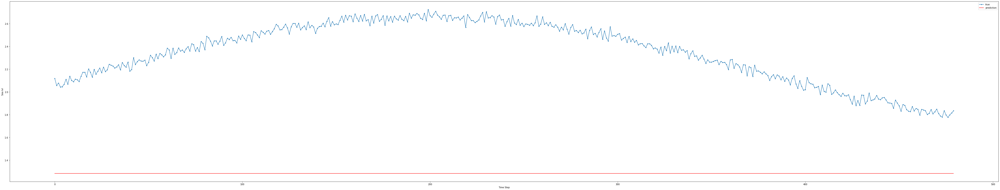

1 [2, 2, 10, 480]


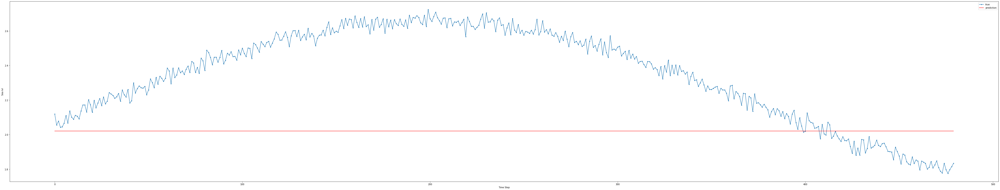

2 [2, 3, 5, 480]


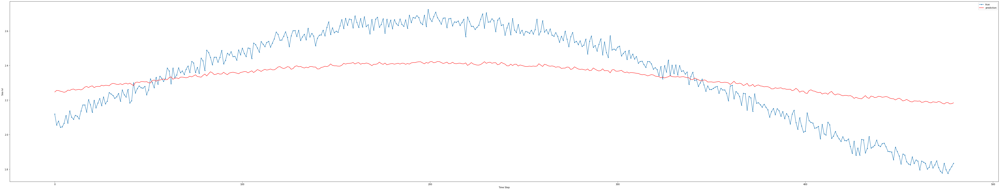

3 [2, 3, 10, 480]


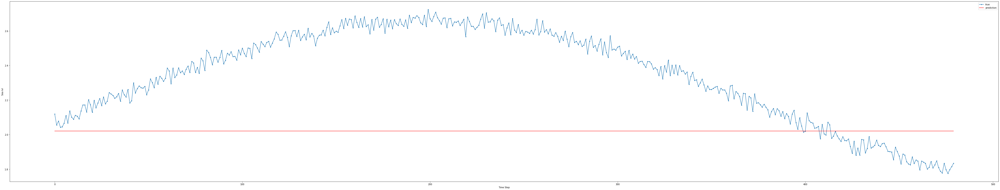

4 [2, 4, 5, 480]


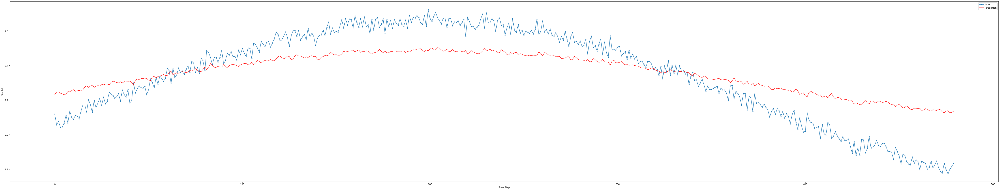

5 [2, 4, 10, 480]


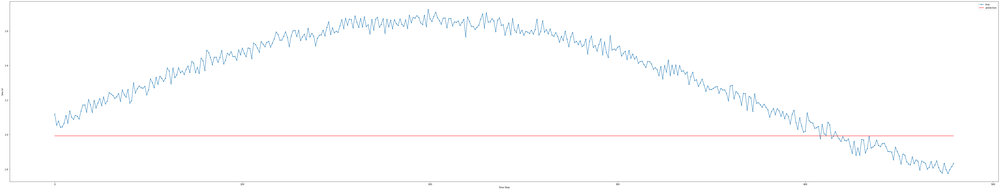

6 [2, 5, 5, 480]


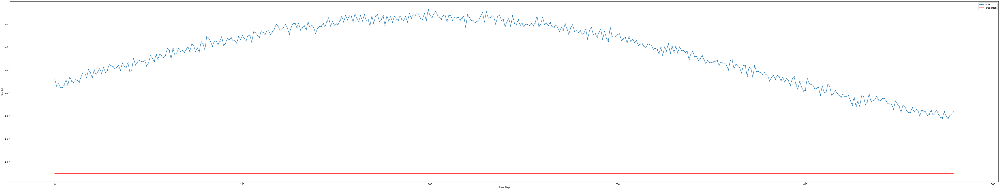

7 [2, 5, 10, 480]


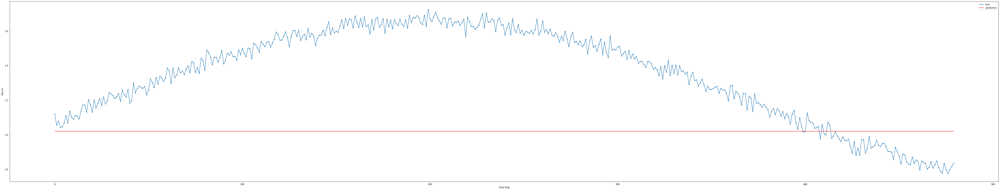

8 [2, 6, 5, 480]


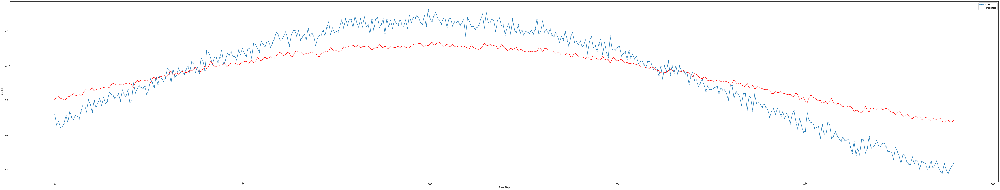

9 [2, 6, 10, 480]


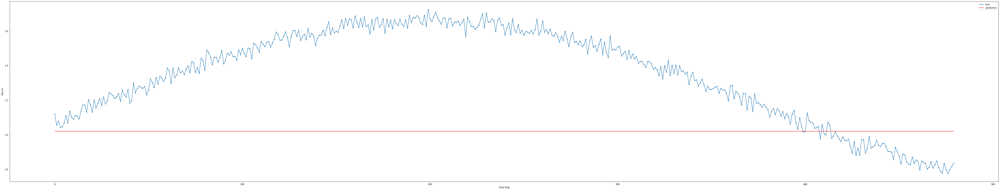

10 [2, 7, 5, 480]


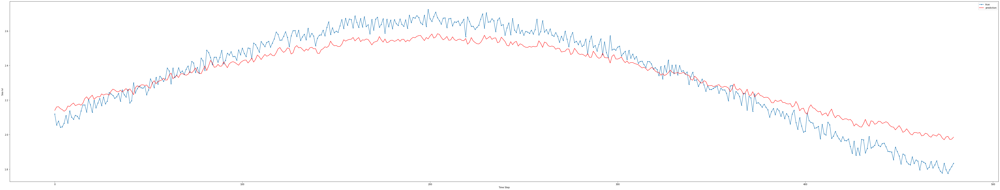

11 [2, 7, 10, 480]


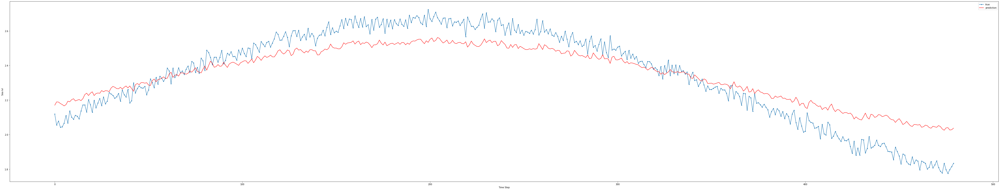

12 [2, 8, 5, 480]


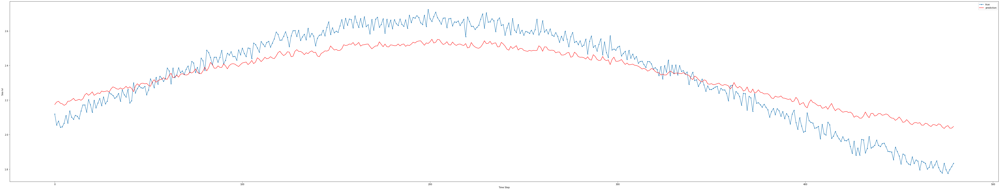

13 [2, 8, 10, 480]


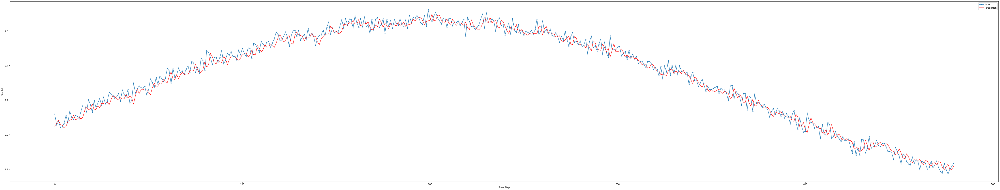

14 [2, 9, 5, 480]


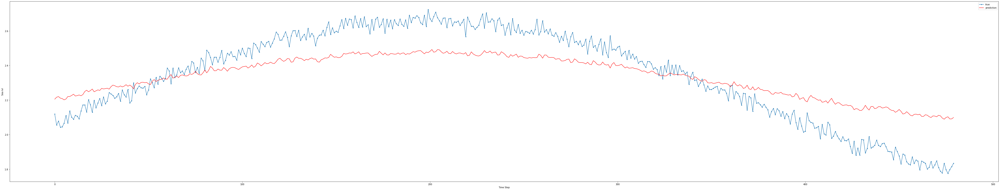

15 [2, 9, 10, 480]


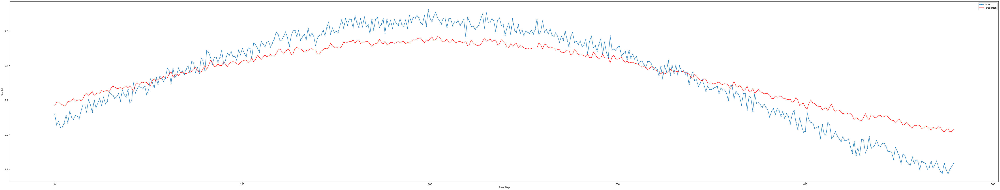

16 [2, 10, 5, 480]


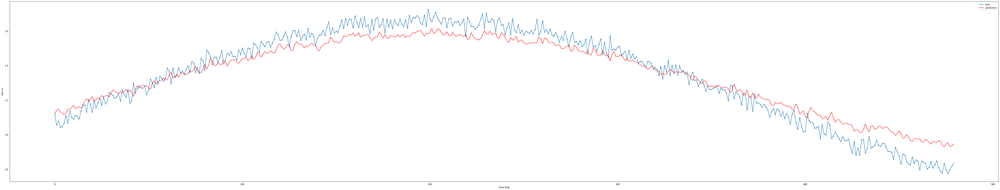

17 [2, 10, 10, 480]


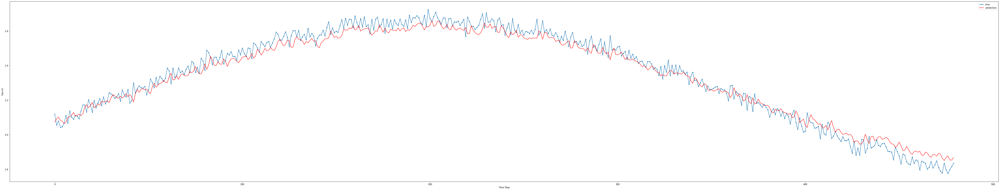

18 [3, 2, 5, 480]


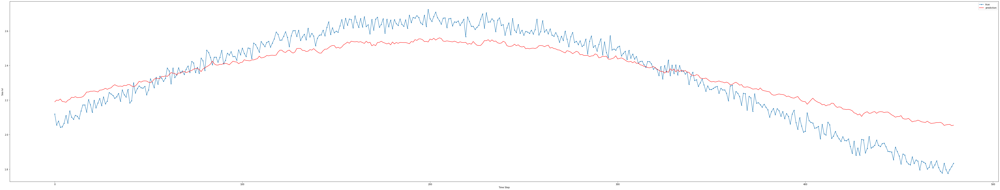

19 [3, 2, 10, 480]


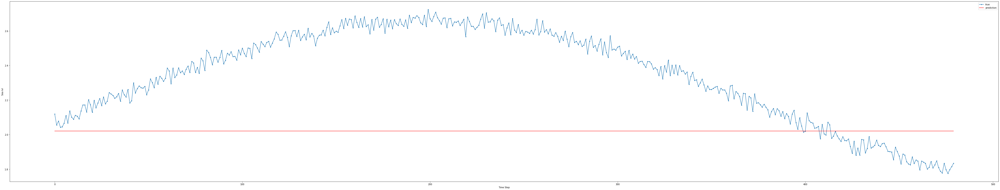

20 [3, 3, 5, 480]


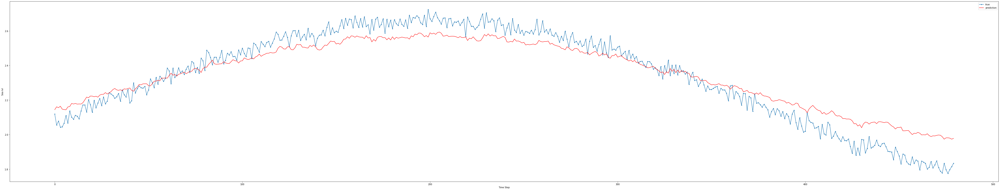

21 [3, 3, 10, 480]


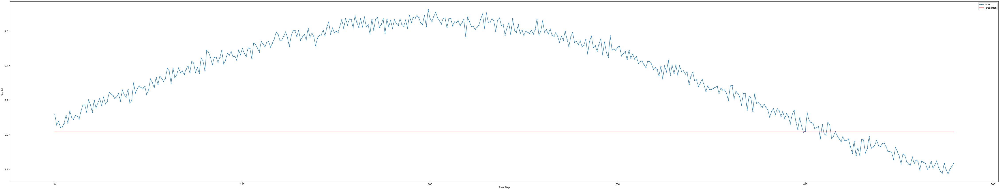

22 [3, 4, 5, 480]


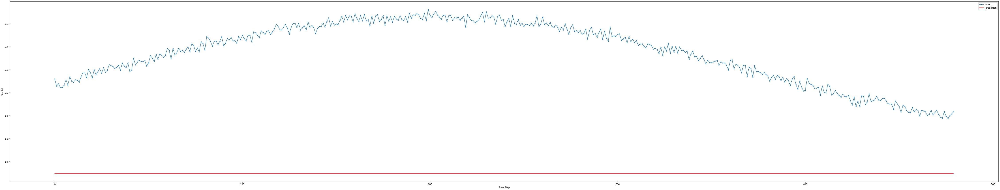

23 [3, 4, 10, 480]


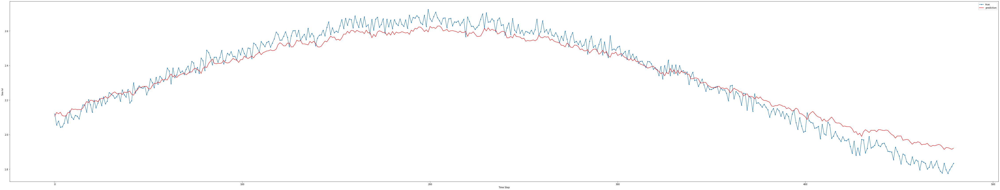

24 [3, 5, 5, 480]


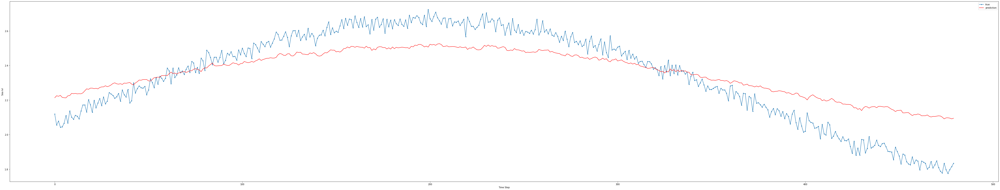

25 [3, 5, 10, 480]


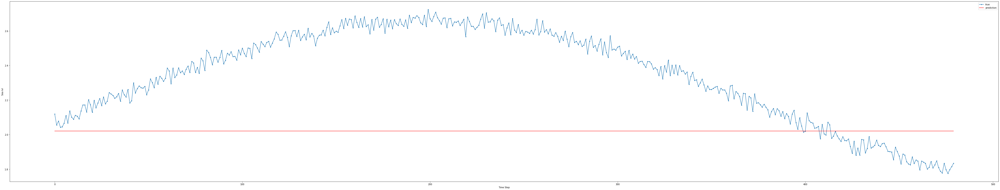

26 [3, 6, 5, 480]


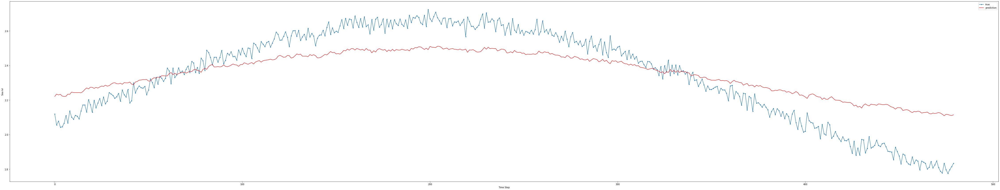

27 [3, 6, 10, 480]


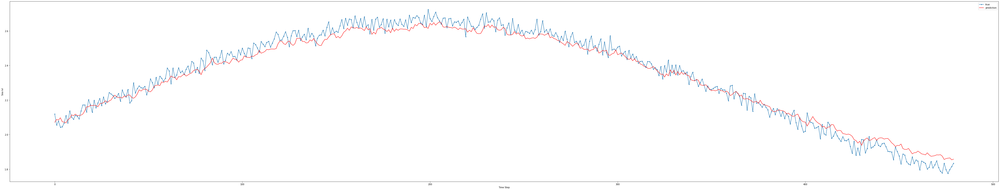

28 [3, 7, 5, 480]


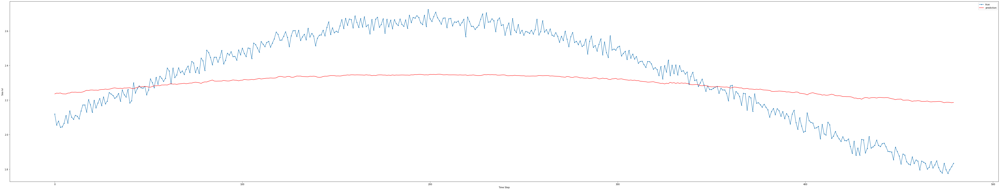

29 [3, 7, 10, 480]


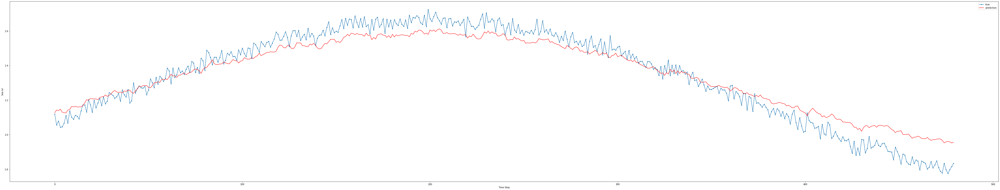

30 [3, 8, 5, 480]


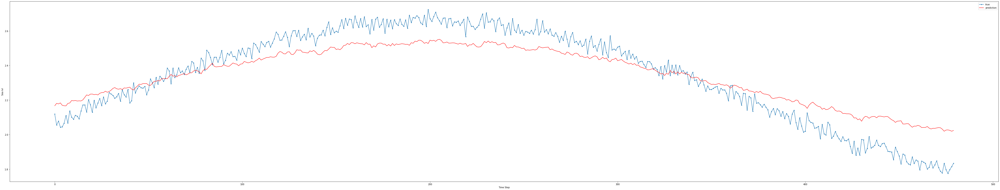

31 [3, 8, 10, 480]


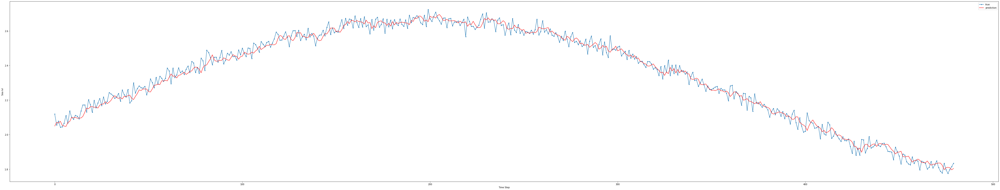

32 [3, 9, 5, 480]


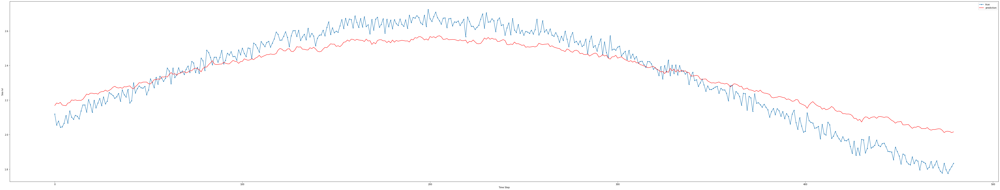

33 [3, 9, 10, 480]


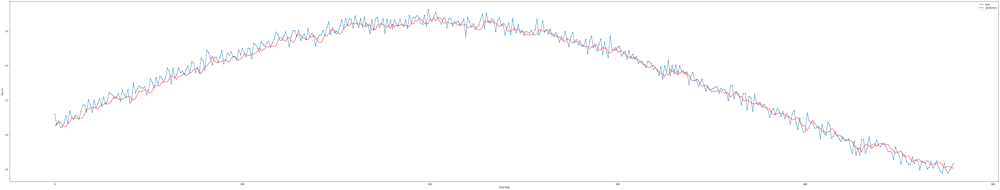

34 [3, 10, 5, 480]


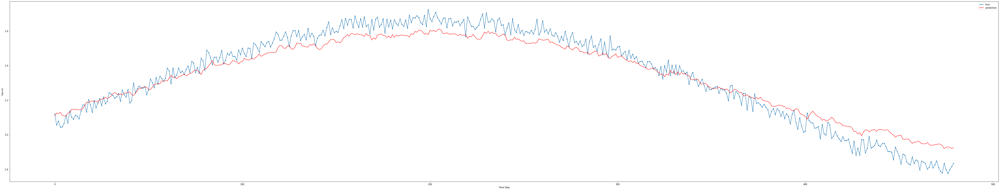

35 [3, 10, 10, 480]


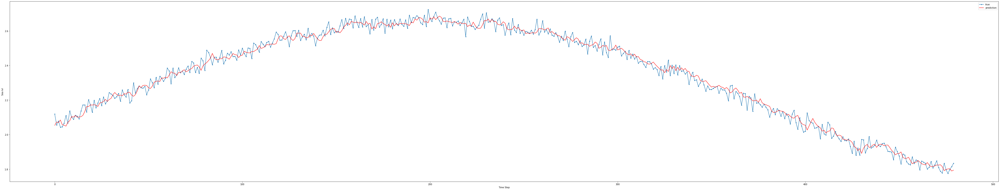

36 [4, 2, 5, 480]


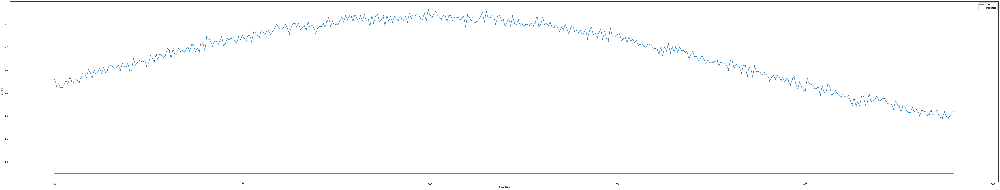

37 [4, 2, 10, 480]


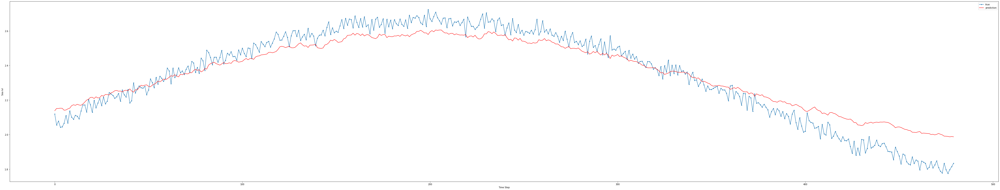

38 [4, 3, 5, 480]


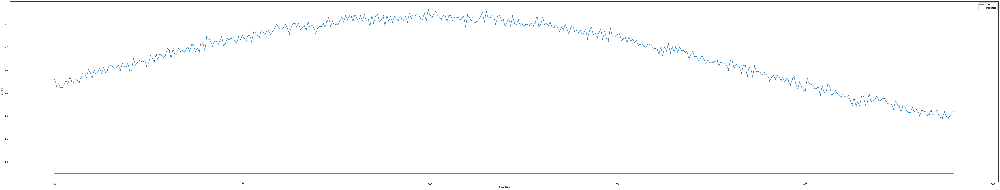

39 [4, 3, 10, 480]


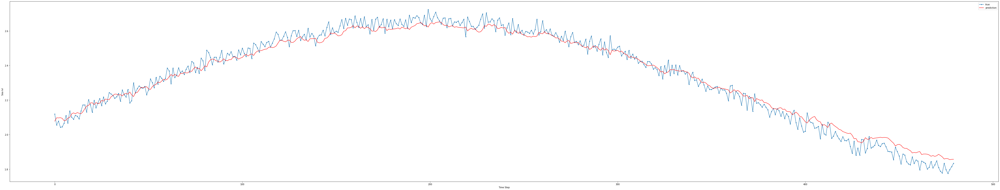

40 [4, 4, 5, 480]


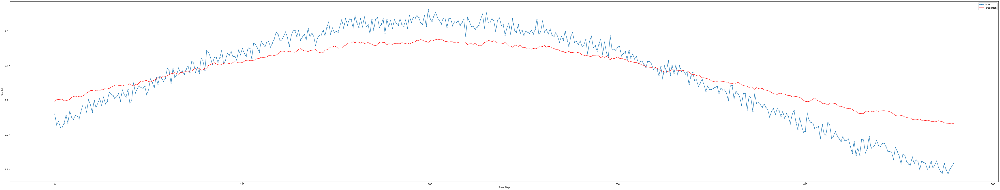

41 [4, 4, 10, 480]


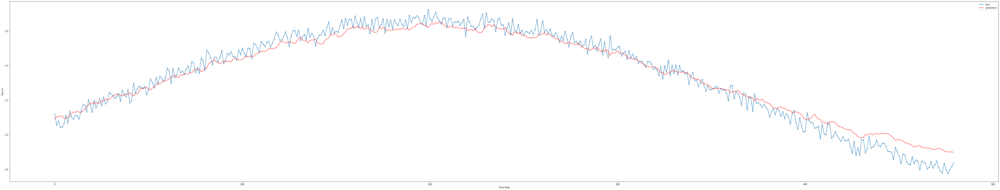

42 [4, 5, 5, 480]


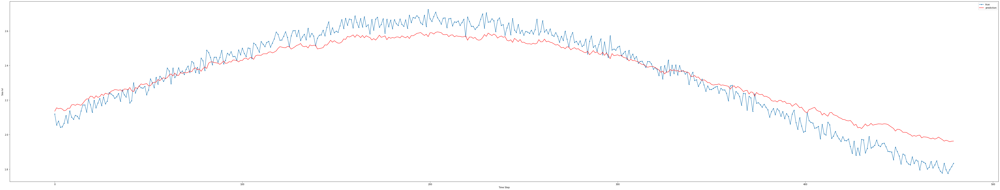

43 [4, 5, 10, 480]


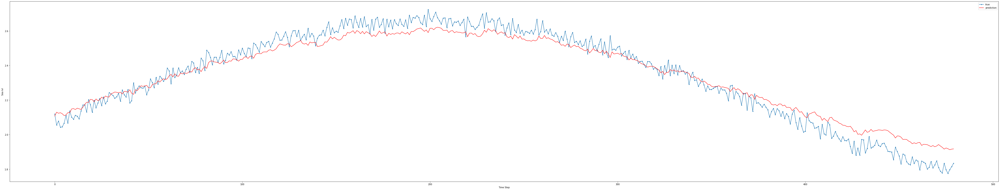

44 [4, 6, 5, 480]


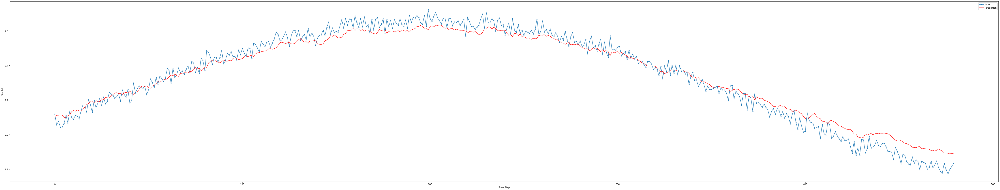

45 [4, 6, 10, 480]


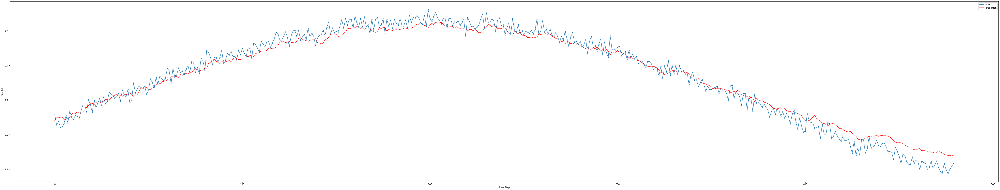

46 [4, 7, 5, 480]


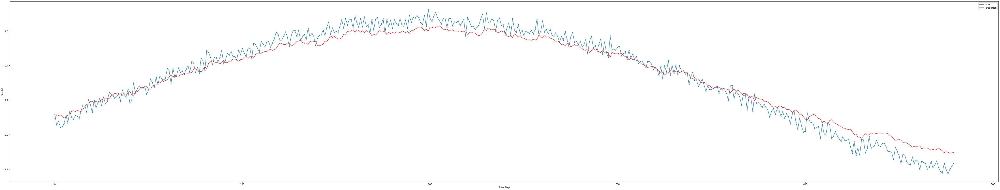

47 [4, 7, 10, 480]


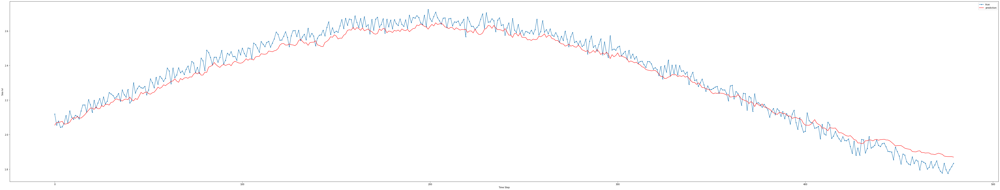

48 [4, 8, 5, 480]


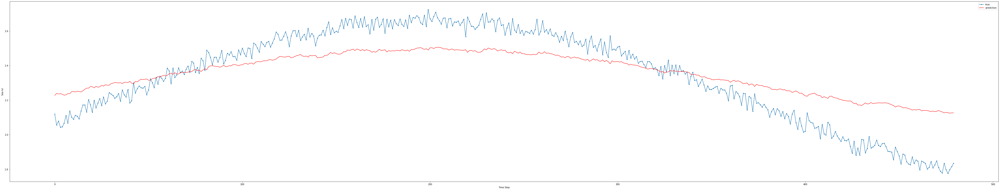

49 [4, 8, 10, 480]


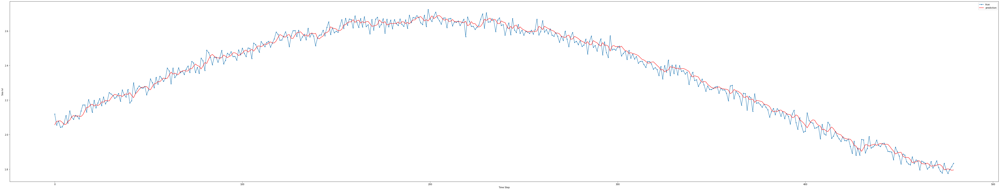

50 [4, 9, 5, 480]


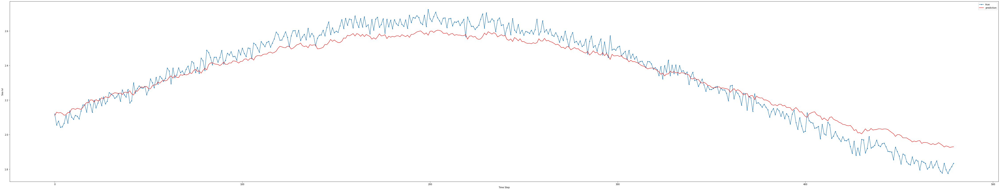

51 [4, 9, 10, 480]


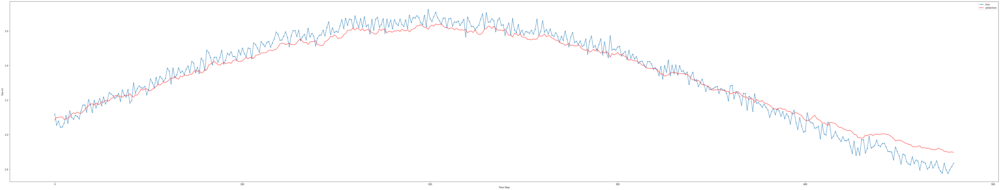

52 [4, 10, 5, 480]


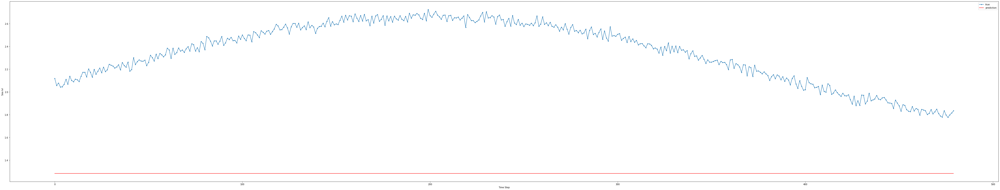

53 [4, 10, 10, 480]


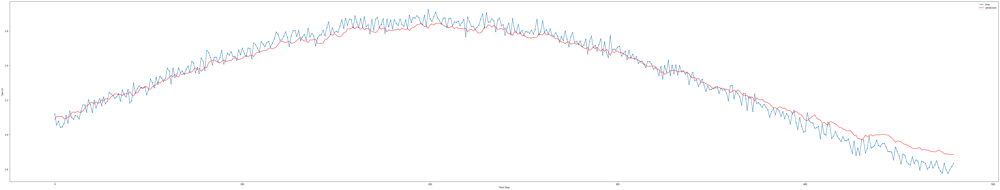

54 [5, 2, 5, 480]


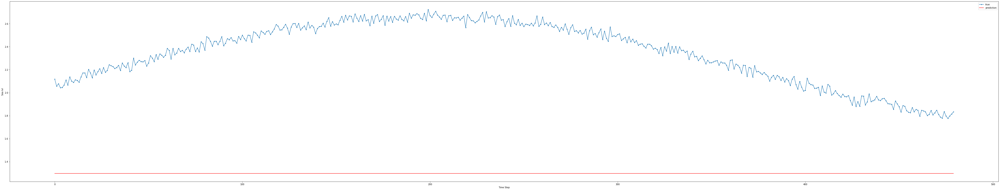

55 [5, 2, 10, 480]


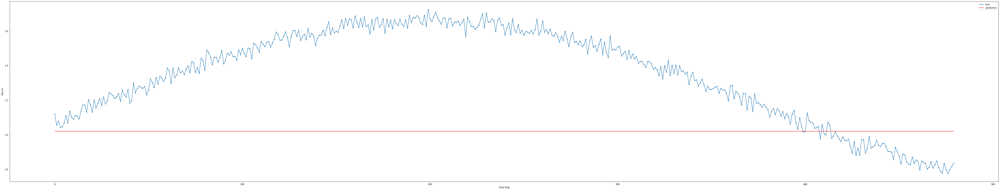

56 [5, 3, 5, 480]


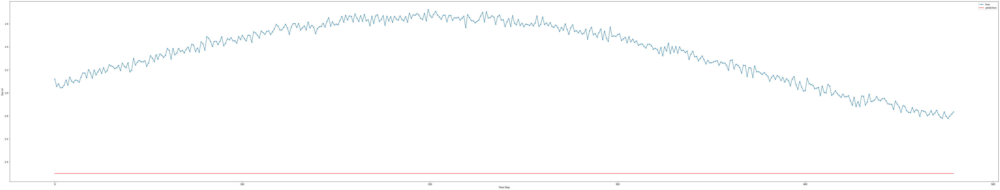

57 [5, 3, 10, 480]


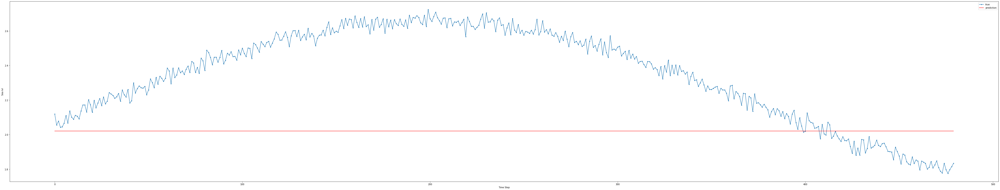

58 [5, 4, 5, 480]


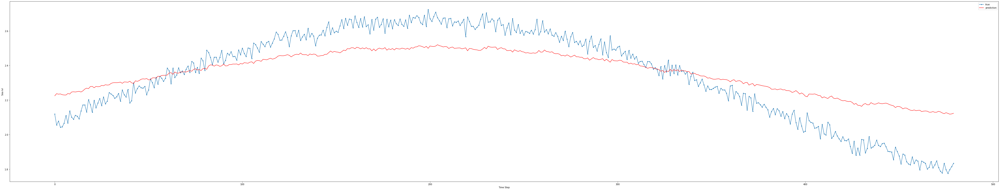

59 [5, 4, 10, 480]


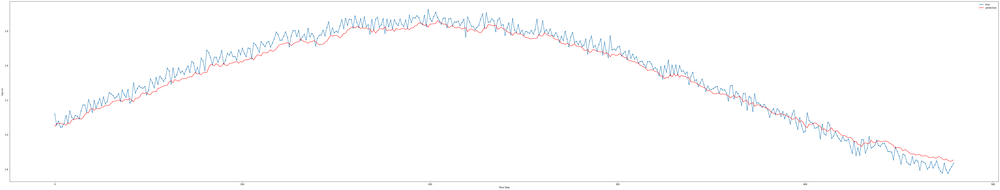

60 [5, 5, 5, 480]


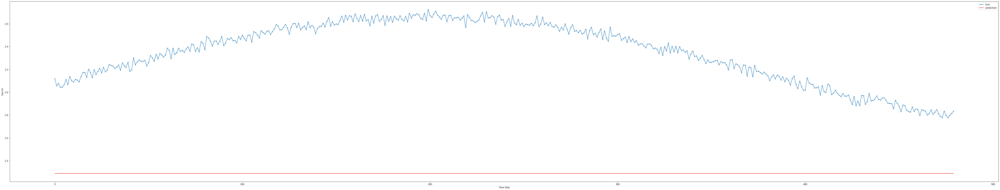

61 [5, 5, 10, 480]


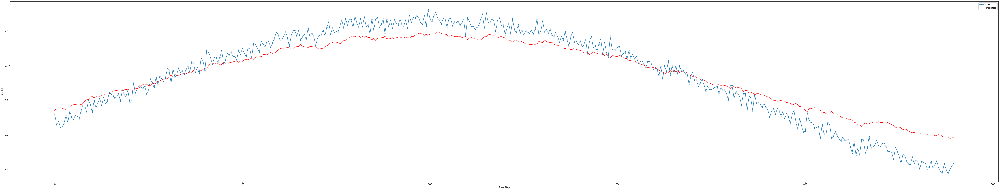

62 [5, 6, 5, 480]


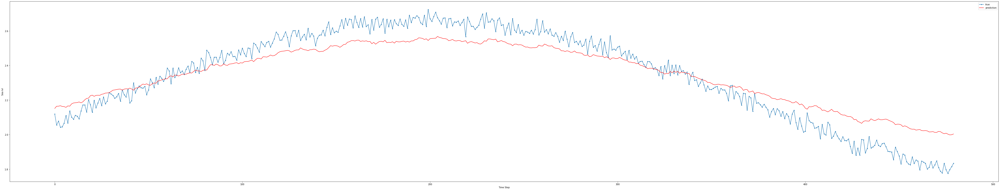

63 [5, 6, 10, 480]


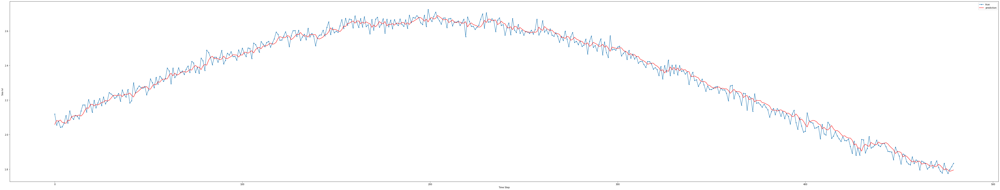

64 [5, 7, 5, 480]


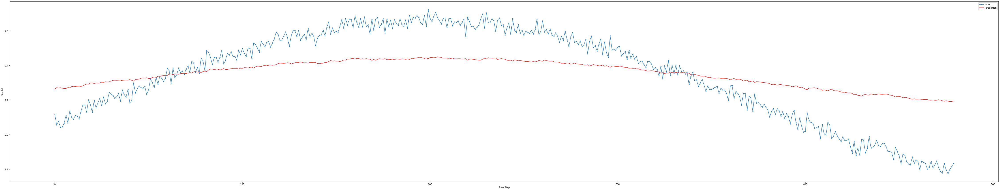

65 [5, 7, 10, 480]


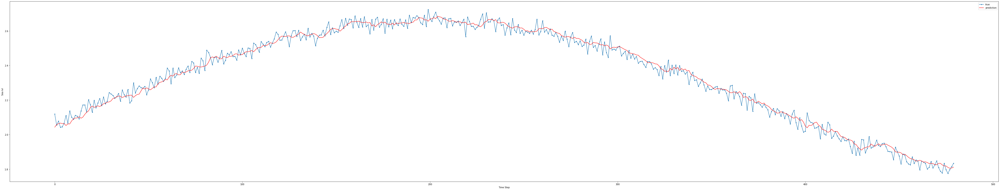

66 [5, 8, 5, 480]


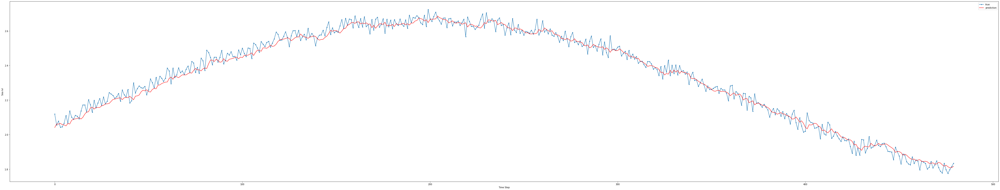

67 [5, 8, 10, 480]


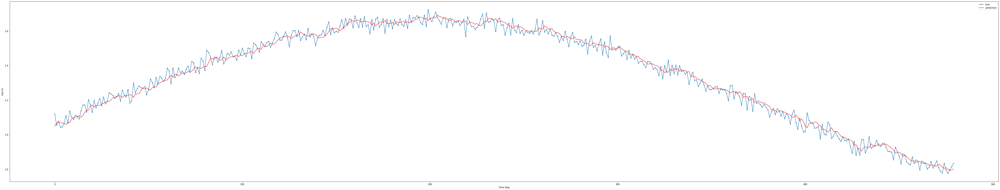

68 [5, 9, 5, 480]


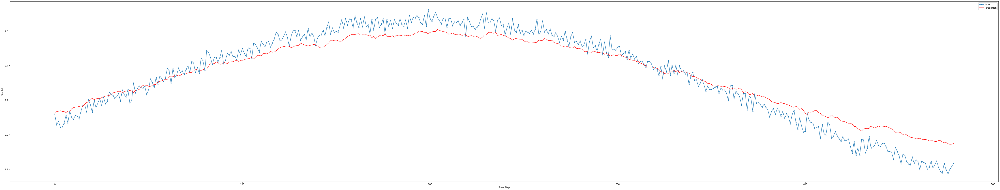

69 [5, 9, 10, 480]


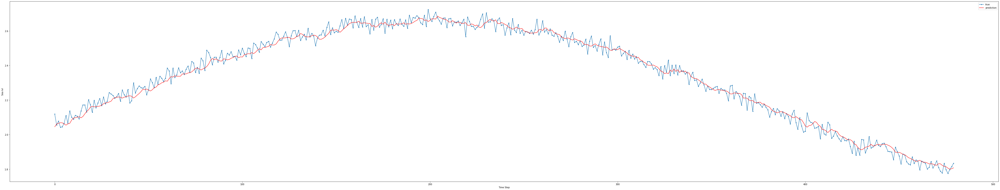

70 [5, 10, 5, 480]


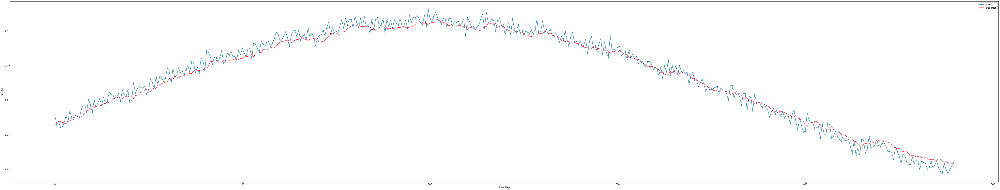

71 [5, 10, 10, 480]


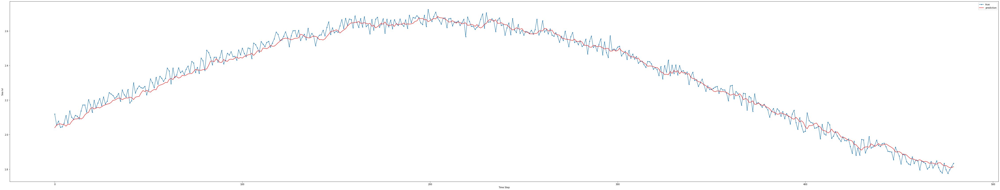

In [29]:
for i in range(len(cnf)):
    dfp = pd.read_csv('predictions'+ str(i) +'.csv',sep=',', header=0, index_col=0, squeeze=True, parse_dates=True)
    print(i, cnf[i])
    #timesteps for predictions
    
    predictions= dfp.values
    plt.rcParams["figure.figsize"] = (80,15)
    plt.plot(test[:480] , marker='.', label="true")
    plt.plot( dfp.values, 'r', label="prediction")
    plt.ylabel('Sea lvl')
    plt.xlabel('Time Step')
    plt.legend()
    plt.show();

# The best ones

13 [2, 8, 10, 480]


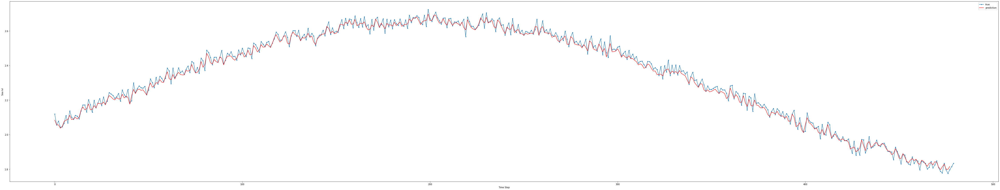

In [36]:
i=13
dfp = pd.read_csv('predictions'+ str(i) +'.csv',sep=',', header=0, index_col=0, squeeze=True, parse_dates=True)
print(i, cnf[i])
#timesteps for predictions
predictions= dfp.values
plt.rcParams["figure.figsize"] = (80,15)
plt.plot(test[:480] , marker='.', label="true")
plt.plot( dfp.shift(periods=-2).values, 'r', label="prediction")
plt.ylabel('Sea lvl')
plt.xlabel('Time Step')
plt.legend()
plt.show();

31 [3, 8, 10, 480]


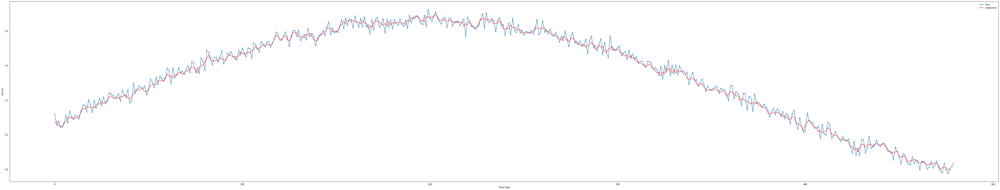

In [37]:
i=31
dfp = pd.read_csv('predictions'+ str(i) +'.csv',sep=',', header=0, index_col=0, squeeze=True, parse_dates=True)
print(i, cnf[i])
#timesteps for predictions
predictions= dfp.values
plt.rcParams["figure.figsize"] = (80,15)
plt.plot(test[:480] , marker='.', label="true")
plt.plot( dfp.shift(periods=-2).values, 'r', label="prediction")
plt.ylabel('Sea lvl')
plt.xlabel('Time Step')
plt.legend()
plt.show();

33 [3, 9, 10, 480]


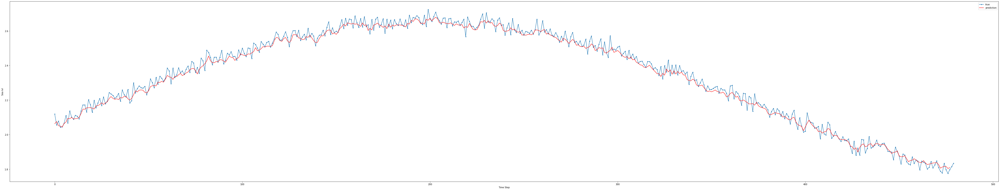

In [38]:
i=33
dfp = pd.read_csv('predictions'+ str(i) +'.csv',sep=',', header=0, index_col=0, squeeze=True, parse_dates=True)
print(i, cnf[i])
#timesteps for predictions
predictions= dfp.values
plt.rcParams["figure.figsize"] = (80,15)
plt.plot(test[:480] , marker='.', label="true")
plt.plot( dfp.shift(periods=-2).values, 'r', label="prediction")
plt.ylabel('Sea lvl')
plt.xlabel('Time Step')
plt.legend()
plt.show();

49 [4, 8, 10, 480]


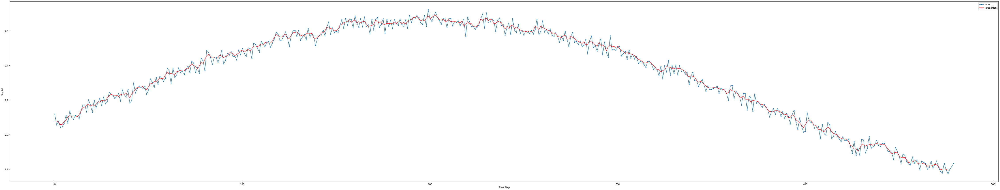

In [39]:
i=49
dfp = pd.read_csv('predictions'+ str(i) +'.csv',sep=',', header=0, index_col=0, squeeze=True, parse_dates=True)
print(i, cnf[i])
#timesteps for predictions
predictions= dfp.values
plt.rcParams["figure.figsize"] = (80,15)
plt.plot(test[:480] , marker='.', label="true")
plt.plot( dfp.shift(periods=-2).values, 'r', label="prediction")
plt.ylabel('Sea lvl')
plt.xlabel('Time Step')
plt.legend()
plt.show();